<a href="https://colab.research.google.com/github/steubk/White-box-Cartoonization/blob/inference-tf-2.x/Check_inference_with_tf_2_x.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Sun Jul  5 19:04:20 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8    10W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

##Test inference with tensorflow 2.x

In [2]:
!git clone --branch inference-tf-2.x https://github.com/steubk/White-box-Cartoonization.git

Cloning into 'White-box-Cartoonization'...
remote: Enumerating objects: 6, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 181 (delta 0), reused 2 (delta 0), pack-reused 175
Receiving objects: 100% (181/181), 44.60 MiB | 10.67 MiB/s, done.
Resolving deltas: 100% (59/59), done.


In [3]:
!pip install tf_slim 

In [4]:
%%time
import tensorflow as tf
print(f"tf_version:{tf.__version__}")

import os
os.chdir('./White-box-Cartoonization/test_code')
!python cartoonize.py

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or 

tf_version:1.12.0
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Pas

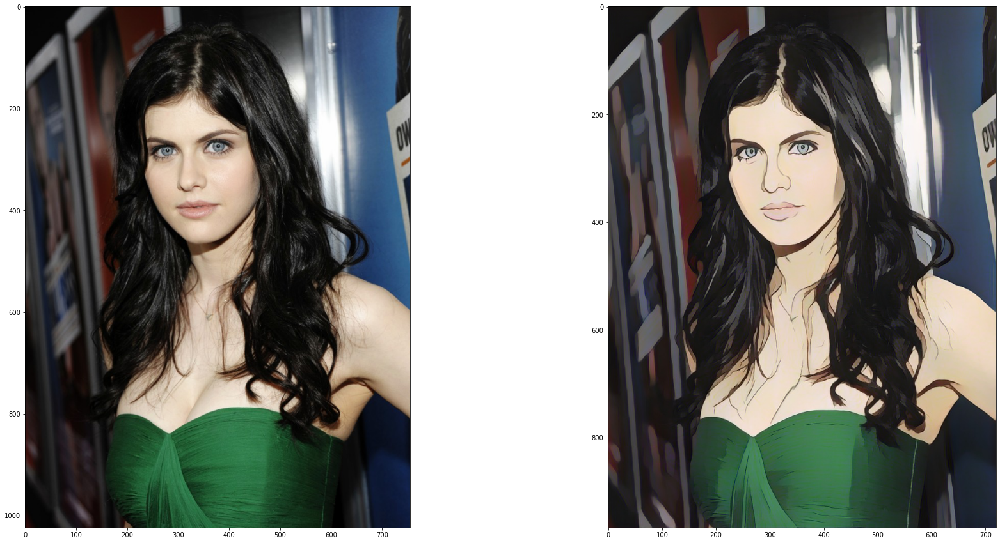

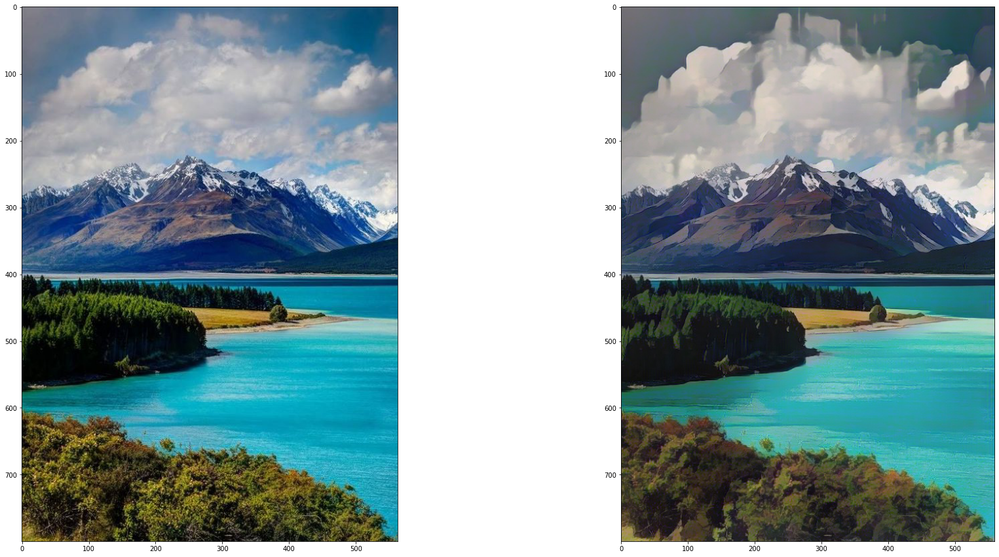

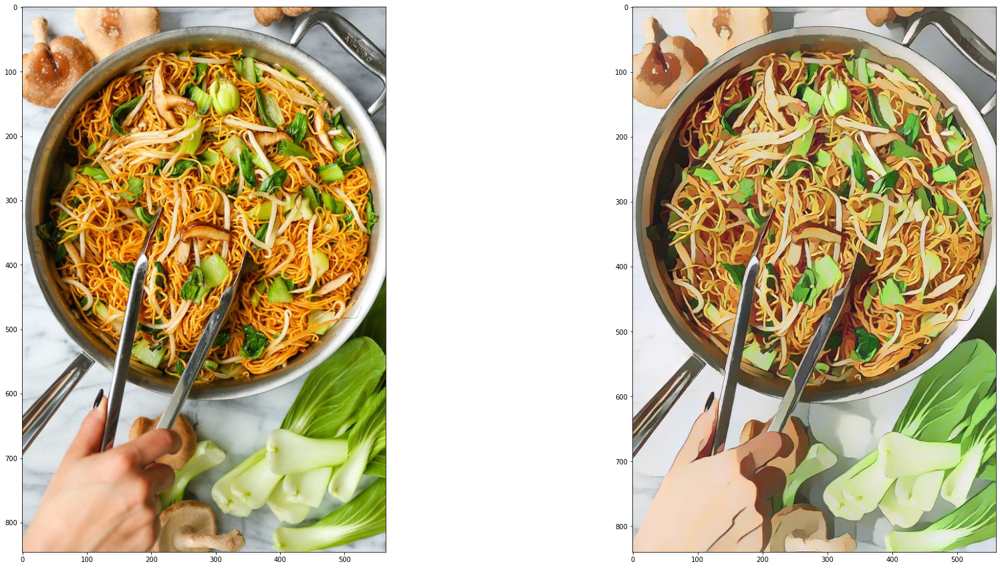

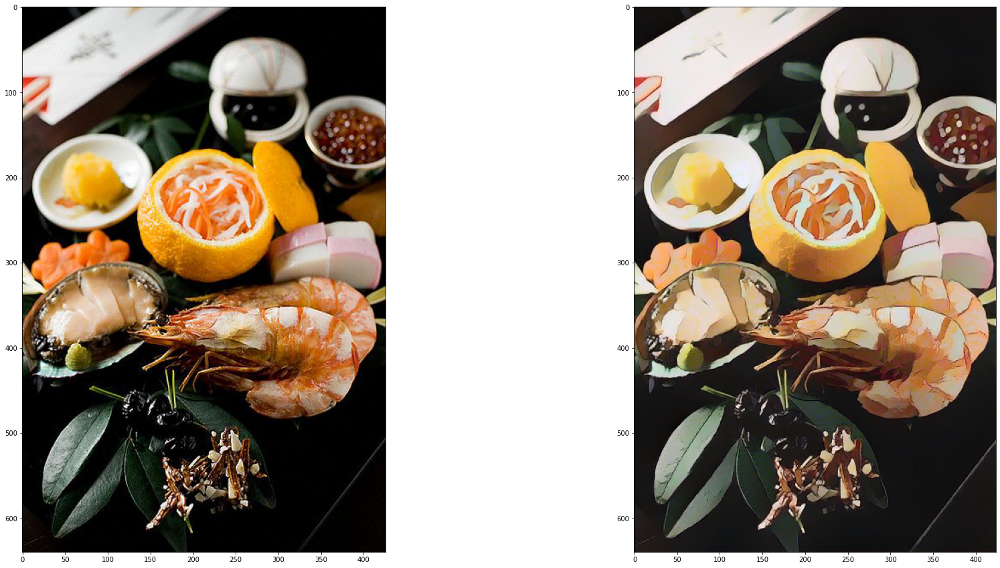

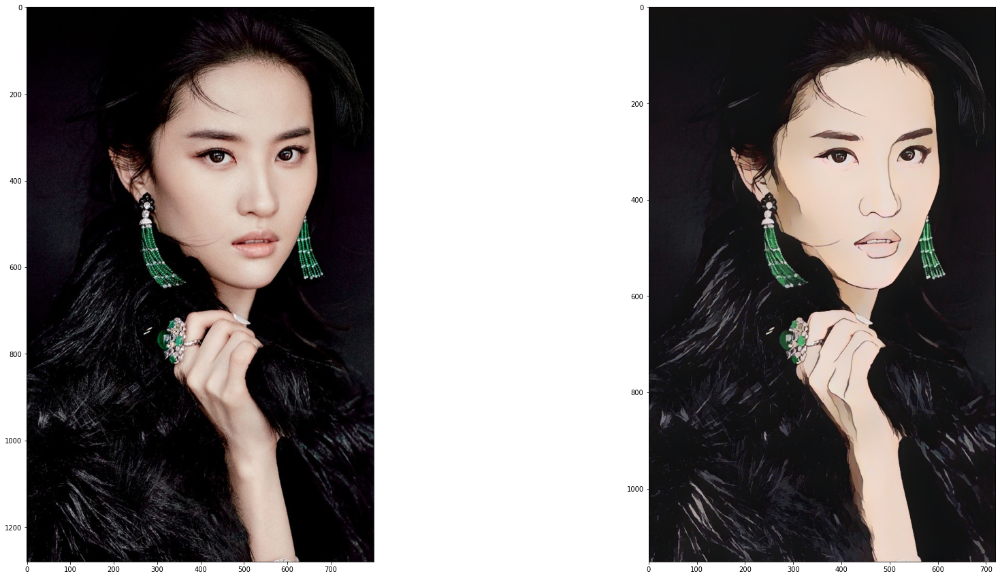

...

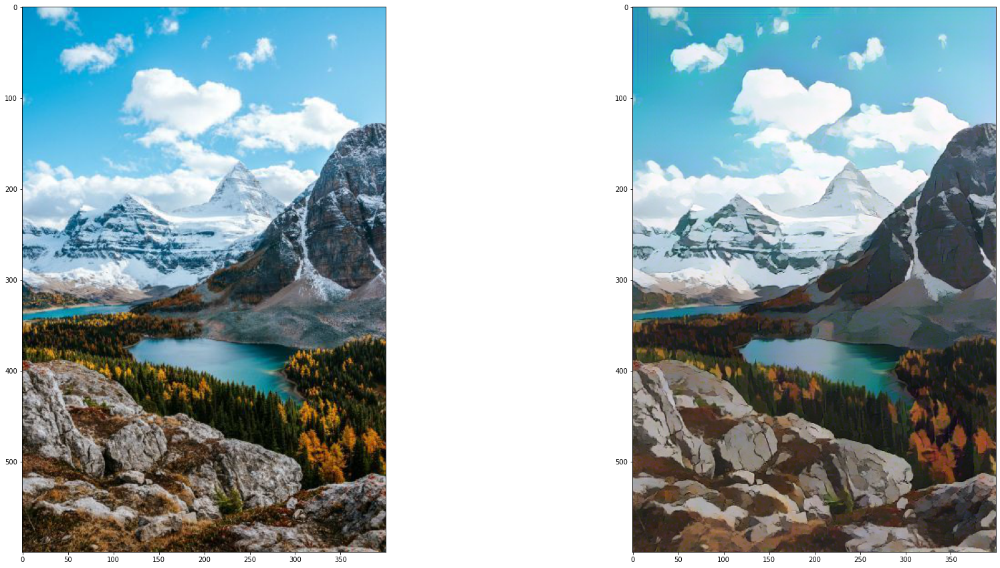

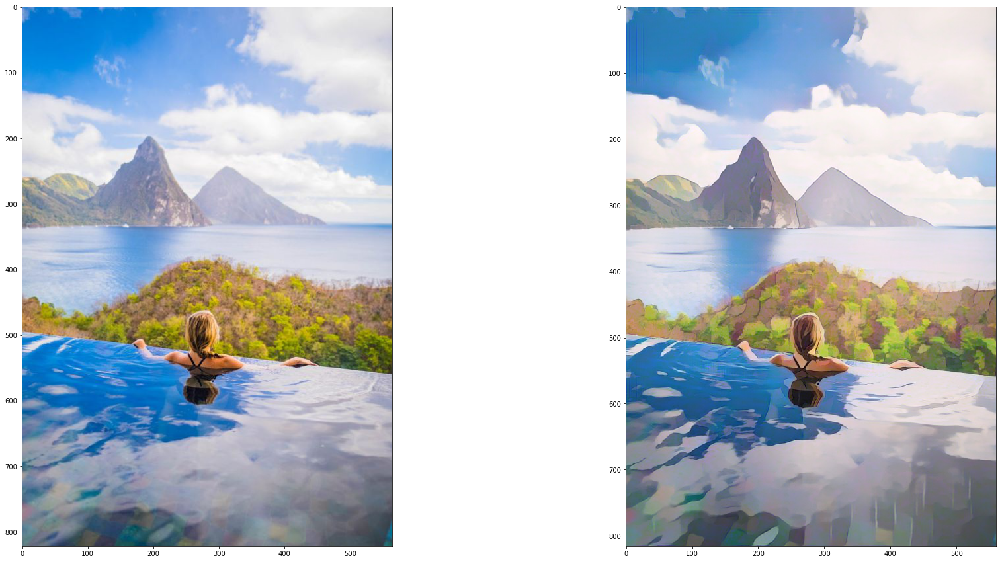

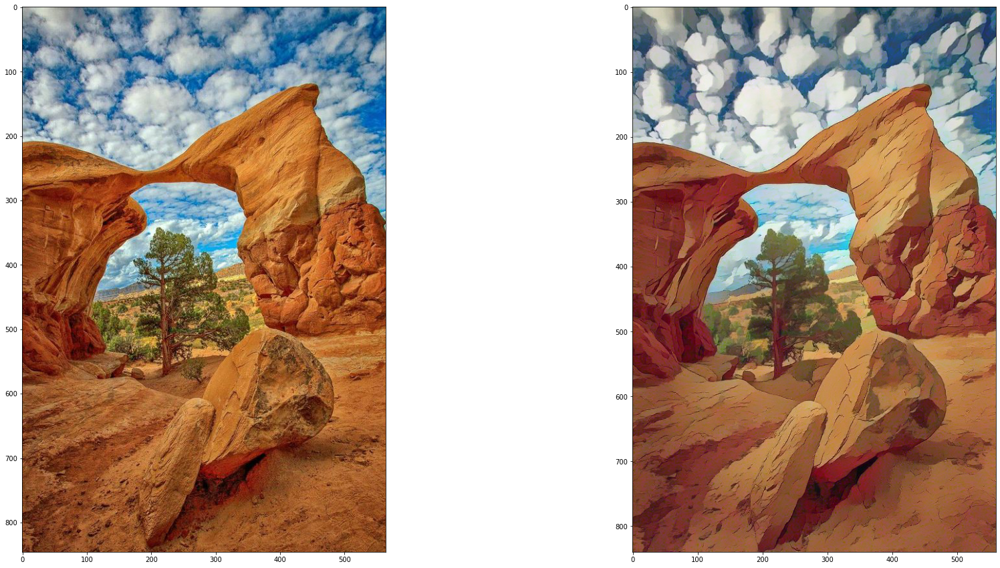

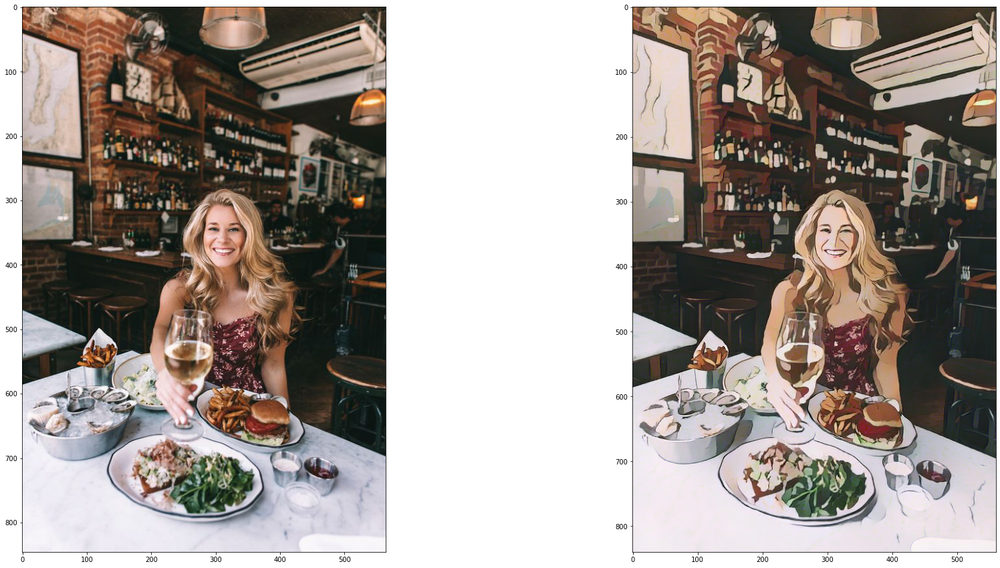

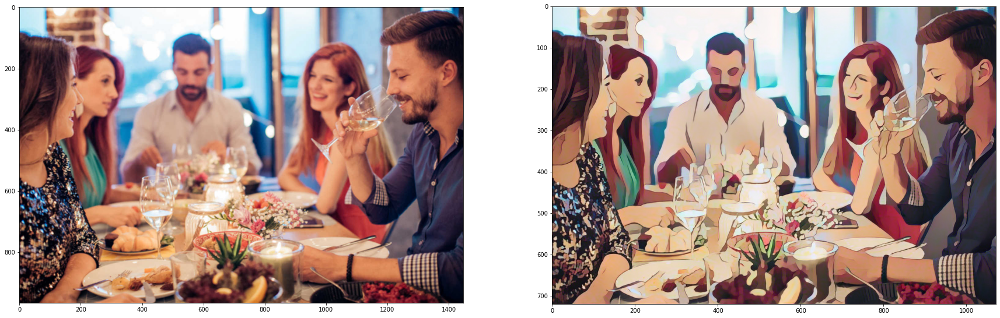

In [5]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

save_folder = '/content/White-box-Cartoonization/test_code/cartoonized_images'
load_folder = '/content/White-box-Cartoonization/test_code/test_images'

name_list = sorted(os.listdir(save_folder))

for i,name in enumerate(name_list):
  fig = plt.figure(figsize= (30, 15))
  axes = fig.subplots(nrows=1, ncols=2)

  image = load_folder + "/" + name
  cartoon = save_folder + "/" + name
  im = Image.open(image) 
  im_array = np.asarray(im)
  axes[0].imshow(im_array)

  im = Image.open(cartoon) 
  im_array = np.asarray(im)
  axes[1].imshow(im_array)
  plt.show()


In [8]:
import sys
sys.path.append('/content/White-box-Cartoonization/test_code')

In [ ]:
import cartoonize
import os


model_path = '/content/White-box-Cartoonization/test_code/saved_models'
load_folder = '/content/White-box-Cartoonization/test_code/test_images'
save_folder = '/content/White-box-Cartoonization/test_code/cartoonized_images'
if not os.path.exists(save_folder):
    os.mkdir(save_folder)
    
cartoonize.cartoonize(load_folder, save_folder, model_path)

INFO:tensorflow:Restoring parameters from /content/White-box-Cartoonization/test_code/saved_models/model-33999


  9%|▉         | 1/11 [00:08<01:27,  8.71s/it]

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

name_list = sorted(os.listdir(save_folder))

for i,name in enumerate(name_list):
  fig = plt.figure(figsize= (30, 15))
  axes = fig.subplots(nrows=1, ncols=2)

  image = load_folder + "/" + name
  cartoon = save_folder + "/" + name
  im = Image.open(image) 
  im_array = np.asarray(im)
  axes[0].imshow(im_array)

  im = Image.open(cartoon) 
  im_array = np.asarray(im)
  axes[1].imshow(im_array)
  plt.show()
